In [140]:
import pandas as pd
import plotly.graph_objects as go

In [137]:
df=pd.read_csv("https://raw.githubusercontent.com/StatCan/hackathon-ginyu-force-data/main/SAMPLE-ESTMA-data.csv" , thousands=',')
entity_list=sorted(df['entity'].unique())
payment_list=df['payment_category'].unique()
df.set_index("entity", inplace=True)

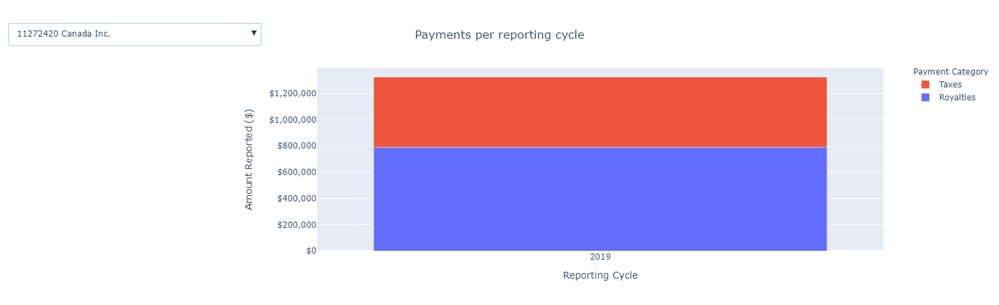

In [139]:
def entity(entity_name):
    e=df.loc[[entity_name],['reporting_cylce','payment_category', 'amount_reported_cad']]
    d=e.groupby(["reporting_cylce","payment_category"])["amount_reported_cad"].sum()
    data_frame=d.to_frame().reset_index()
    return data_frame


fig = go.Figure()
default_state=entity_list[0]
region_plot_names = []
buttons=[]
for e in entity_list:
    d=entity(e)
    payment_types=d['payment_category'].unique()
    for name in payment_types:
        frame=d.loc[d['payment_category']==name]
        fig.add_trace(go.Bar(name=name, x=frame['reporting_cylce'], y=frame['amount_reported_cad'], visible=(e==default_state)))
    region_plot_names.extend([e]* len(payment_types))

for entity in entity_list:
    buttons.append(dict(method='update',
                        label=entity,
                        args = [{'visible': [entity==r for r in region_plot_names]}]))
    
    
fig.update_layout(showlegend=True, 
        yaxis_tickprefix = '$',
        yaxis_tickformat = ',.',
        legend_title="Payment Category",
        title={
        'text': "Payments per reporting cycle",
        'y':0.9,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'},
        yaxis_title="Amount Reported ($)", 
        xaxis_title="Reporting Cycle", 
        updatemenus=[{"buttons": buttons, "direction": "down", "active": list(entity_list).index(default_state), "showactive": True, "x": -0.10, "y": 1.25}])
fig.update_layout(legend=dict(
    orientation="v",
    y=1.02,
    x=1.05
))
fig.update_yaxes(autorange=True)    
fig.update_layout(barmode='stack')
fig.update_xaxes(type='category')
fig.show()
